In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/child-mind-institute-detect-sleep-states/train_series.parquet
/kaggle/input/child-mind-institute-detect-sleep-states/sample_submission.csv
/kaggle/input/child-mind-institute-detect-sleep-states/train_events.csv
/kaggle/input/child-mind-institute-detect-sleep-states/test_series.parquet


In [ ]:
!pip install metric

In [20]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import polars as pl
import datetime 
from tqdm import tqdm
from metric import score
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go



# These are variables to be used by the score function
column_names = {
    'series_id_column_name': 'series_id',
    'time_column_name': 'step',
    'event_column_name': 'event',
    'score_column_name': 'score',
}

tolerances = {
    'onset': [12, 36, 60, 90, 120, 150, 180, 240, 300, 360], 
    'wakeup': [12, 36, 60, 90, 120, 150, 180, 240, 300, 360]
}

# This dictionary contains tolerance values for event detection.
# Tolerance represents the allowable difference between the predicted event time and the actual event time. 
# The values are stored as lists for 'onset' and 'wakeup' events.
# For example, if the predicted 'onset' event time is within 12 time steps (or 12 units) of the actual 'onset' event time, it is considered a correct prediction. The same applies to 'wakeup' events.


ModuleNotFoundError: No module named 'metric'

In [4]:
# Importing data 

# Column transformations

dt_transforms = [
    pl.col('timestamp').str.to_datetime(), 
    (pl.col('timestamp').str.to_datetime().dt.year()-2000).cast(pl.UInt8).alias('year'), 
    pl.col('timestamp').str.to_datetime().dt.month().cast(pl.UInt8).alias('month'),
    pl.col('timestamp').str.to_datetime().dt.day().cast(pl.UInt8).alias('day'), 
    pl.col('timestamp').str.to_datetime().dt.hour().cast(pl.UInt8).alias('hour')
]

data_transforms = [
    pl.col('anglez').cast(pl.Int16), # Casting anglez to 16 bit integer
    (pl.col('enmo')*1000).cast(pl.UInt16), # Convert enmo to 16 bit uint
]

train_series = pl.scan_parquet('/kaggle/input/child-mind-institute-detect-sleep-states/train_series.parquet').with_columns(
    dt_transforms + data_transforms
    )

train_events = pl.read_csv('/kaggle/input/child-mind-institute-detect-sleep-states/train_events.csv').with_columns(
    dt_transforms
    )

test_series = pl.scan_parquet('/kaggle/input/child-mind-institute-detect-sleep-states/test_series.parquet').with_columns(
    dt_transforms + data_transforms
    )

# Getting series ids as a list for convenience
series_ids = train_events['series_id'].unique(maintain_order=True).to_list()

# Removing series with mismatched counts: 
onset_counts = train_events.filter(pl.col('event')=='onset').group_by('series_id').count().sort('series_id')['count']
wakeup_counts = train_events.filter(pl.col('event')=='wakeup').group_by('series_id').count().sort('series_id')['count']

counts = pl.DataFrame({'series_id':sorted(series_ids), 'onset_counts':onset_counts, 'wakeup_counts':wakeup_counts})
count_mismatches = counts.filter(counts['onset_counts'] != counts['wakeup_counts'])

train_series = train_series.filter(~pl.col('series_id').is_in(count_mismatches['series_id']))
train_events = train_events.filter(~pl.col('series_id').is_in(count_mismatches['series_id']))

# Updating list of series ids, not including series with no non-null values.
series_ids = train_events.drop_nulls()['series_id'].unique(maintain_order=True).to_list()

We also note the presence of missing labels in some of the series. That is, for some series there are days in which no onsets or wakeups are recorded, even though the time series data indicate periods where the participant likely was sleeping. Let's see how frequently this appears in our data.

In [7]:
# #Code to check the missing values from our dataset
# missing_data = train_events.group_by('series_id', maintain_order=True).agg(pl.col('step').map_elements(lambda x: x.is_null().any()).alias('MissingValues'))
# print(f"Series with missing data: {missing_data['MissingValues'].sum()}/{train_events['series_id'].n_unique()}")

Series with missing data: 240/277


Now that we can be certain that the onsets and wakeup numbers match, we can define a plotting function that will display our two primary datapoints - anglez and enmo - on a time series for a given series_id, with the sleep stages highlighted. For completeness, we will also flag any days where there are missing or null values.

In [9]:
def getdata(i, every=1) : 
    '''
    Get data for a given sample series. 
    '''
    
    idx = series_ids[i] if type(i) == int else i
    series = train_series.filter((pl.col('series_id') == idx) & (pl.col('step') % every == 0)).collect()
    events = train_events.filter(pl.col('series_id') == idx)
    
    return idx, series, events

def plotdata(idx, series, events) :
    '''
    Plots a time series of anglez and enmo for the i-th series, using a 
    given frequency of samples, with wakeup and onset events marked. 
    every=1 uses every sample at 5 minute intervals, and every=12 gives 
    minute-to-minute time series. 
    '''
    
    fig = make_subplots(specs=[[{'secondary_y': True}]])
    
    # Plotting time series data
    fig.add_trace(go.Scatter(x=series['timestamp'], y=series['anglez'], mode='lines', name='anglez'), secondary_y=False)
    fig.add_trace(go.Scatter(x=series['timestamp'], y=series['enmo'], mode='lines', name='enmo'), secondary_y=True)
    
    # Plotting sleeping periods
    onsets = events.filter((pl.col('event') == 'onset') & (pl.col('timestamp') != None))['timestamp'].to_list()
    wakeups = events.filter((pl.col('event') == 'wakeup') & (pl.col('timestamp') != None))['timestamp'].to_list()
    for onset, wakeup in zip(onsets, wakeups) :
        fig.add_vrect(
            x0=onset, x1=wakeup,
            fillcolor='gray', opacity=0.2,
            layer='below', line_width=0
        )
        
    # Add dummy trace for the legend
    fig.add_trace(go.Scatter(
        x=[None],
        y=[None],
        mode='lines',
        line=dict(color='gray', width=0),
        fill='tozeroy',
        fillcolor='gray',
        opacity=0.2,
        name="Sleeping periods"
    ))
        
    # Plotting days with missing data
    start_date = events['timestamp'].min().replace(hour=0, minute=0, second=0, microsecond=0)
    null_nights = events.filter(pl.col('step').is_null())['night'].unique().to_list()
    for n in null_nights : 
        fig.add_vrect(
            x0=start_date + datetime.timedelta(days=n-1), x1=start_date + datetime.timedelta(days=n),
            fillcolor='violet', opacity=0.2,
            layer='below', line_width=0
        )
    
    # Add dummy trace for the legend
    fig.add_trace(go.Scatter(
        x=[None],
        y=[None],
        mode='lines',
        line=dict(color='violet', width=0),
        fill='tozeroy',
        fillcolor='violet',
        opacity=0.2,
        name="Missing data"
    ))
        
    fig.update_layout(
        title_text=f"Accelerometer Data<br><sub>ID: {idx}</sub>", 
        #template = 'ggplot2',
        xaxis=dict(showgrid=False), yaxis=dict(showgrid=False), yaxis2=dict(showgrid=False)
    )
    
    fig.show()
    
# data = getdata(1)

# plotdata(*data)

#Note: Only run these this cell to visualize the dataset (will take 10-15gb of ram)

In [6]:
# i = 0

# full_data_ids = missing_data.filter(pl.col('MissingValues')==False)['series_id'].to_list()
# idx, series, events = getdata(full_data_ids[i])
# plotdata(idx, series, events)

# onsets = events.filter((pl.col('event') == 'onset') & (pl.col('timestamp') != None))['timestamp'].to_list()
# wakeups = events.filter((pl.col('event') == 'wakeup') & (pl.col('timestamp') != None))['timestamp'].to_list()
#Run this to get the below graph

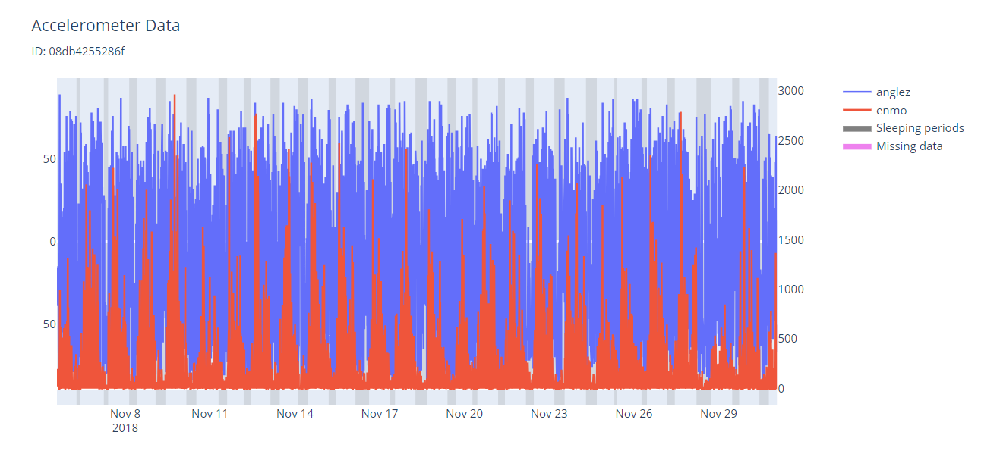

Sample screenshot of the grpah above if not visible in the notebook

## Feature Engineering

The features in this model will consist of
- The current`hour`.
- Rolling aggregates (mean, max, std) of `anglez` and `enmo` over a variety of window sizes, from 5 minutes to 8 hours. 
- Rolling aggregates (mean, max, std) of `anglez` and `enmo` [**total variation**](https://en.wikipedia.org/wiki/Total_variation) (or *first variation*, i.e. 1v) over a variety of window sizes, from 5 minutes to 8 hours.

#### Motivation for using total variation 

From the above graph we observe that during sleeping periods `anglez` resembles a pure [jump process](https://en.wikipedia.org/wiki/Jump_process), while during wakeful periods it resembles a [diffusion process](https://en.wikipedia.org/wiki/Diffusion_process), as shown in the following data sample:

<img src="https://media.licdn.com/dms/image/D5612AQHondzoUGc1tA/article-inline_image-shrink_1000_1488/0/1695767830342?e=1701907200&v=beta&t=3Zf5RuZpGNGHUyAl7g-B7J9ftZaQrGPze4l1XegKkpU" width="800" />

Importantly, jump and diffusion processes can be distinguished by what is known as their [**total variation**](https://en.wikipedia.org/wiki/Total_variation) - essentially, the sum total of the absolute differences between the points. For diffusion processes, which jiggle around constantly, the total variation is infinite, while for jump processes, which only change by finite amounts a countable number of times, the total variation is finite.

<img src="https://media.licdn.com/dms/image/D5612AQGNsJtKsGREyQ/article-inline_image-shrink_1500_2232/0/1696293678614?e=1701907200&v=beta&t=iTZutqlUHm7pvv-d1pKAHoAYO5Va9Z_1Tjjee3B4dgg" width="650" />

For non-continuous, evenly sampled functions such as our time series, the total variation of a function $f(t)$ on an interval $[a,b]$ can be defined simply as

$$V_a^b(f) := \sum_{j=0}^{n-1} |f(t_{j+1}) - f(t_j)|$$

where $t_0=a$, $t_n=b$, and $\forall j: t_{j+1}-t_j = \frac{a-b}{n}$. This can be calculated efficiently using Polars' built in `.diff()` and `.abs()` functions. 

These features will give the classification model information which characterizes the stochastic behavior of the variable in the recent past, which can be much more useful for classifying sleep state than the variable value itself.

In [5]:
features, feature_cols = [pl.col('hour')], ['hour']

for mins in [5, 30, 60*2, 60*8] :
    
    for var in ['enmo', 'anglez'] :
        
        features += [
            pl.col(var).rolling_mean(12 * mins, center=True, min_periods=1).abs().cast(pl.UInt16).alias(f'{var}_{mins}m_mean'),
            pl.col(var).rolling_max(12 * mins, center=True, min_periods=1).abs().cast(pl.UInt16).alias(f'{var}_{mins}m_max'),
            pl.col(var).rolling_std(12 * mins, center=True, min_periods=1).abs().cast(pl.UInt16).alias(f'{var}_{mins}m_std')
        ]

        feature_cols += [ 
            f'{var}_{mins}m_mean', f'{var}_{mins}m_max', f'{var}_{mins}m_std'
        ]

        # Getting first variations
        features += [
            (pl.col(var).diff().abs().rolling_mean(12 * mins, center=True, min_periods=1)*10).abs().cast(pl.UInt32).alias(f'{var}_1v_{mins}m_mean'),
            (pl.col(var).diff().abs().rolling_max(12 * mins, center=True, min_periods=1)*10).abs().cast(pl.UInt32).alias(f'{var}_1v_{mins}m_max'),
            (pl.col(var).diff().abs().rolling_std(12 * mins, center=True, min_periods=1)*10).abs().cast(pl.UInt32).alias(f'{var}_1v_{mins}m_std')
        ]

        feature_cols += [ 
            f'{var}_1v_{mins}m_mean', f'{var}_1v_{mins}m_max', f'{var}_1v_{mins}m_std'
        ]

id_cols = ['series_id', 'step', 'timestamp']

train_series = train_series.with_columns(
    features
).select(id_cols + feature_cols)

test_series = test_series.with_columns(
    features
).select(id_cols + feature_cols)

In [6]:
def make_train_dataset(train_data, train_events, drop_nulls=False) :
    
    series_ids = train_data['series_id'].unique(maintain_order=True).to_list()
    X, y = pl.DataFrame(), pl.DataFrame()
    for idx in tqdm(series_ids) : 
        
        # Normalizing sample features
        sample = train_data.filter(pl.col('series_id')==idx).with_columns(
            [(pl.col(col) / pl.col(col).std()).cast(pl.Float32) for col in feature_cols if col != 'hour']
        )
        
        events = train_events.filter(pl.col('series_id')==idx)
        
        if drop_nulls : 
            # Removing datapoints on dates where no data was recorded
            sample = sample.filter(
                pl.col('timestamp').dt.date().is_in(events['timestamp'].dt.date())
            )
        
        X = X.vstack(sample[id_cols + feature_cols])

        onsets = events.filter((pl.col('event') == 'onset') & (pl.col('step') != None))['step'].to_list()
        wakeups = events.filter((pl.col('event') == 'wakeup') & (pl.col('step') != None))['step'].to_list()

        # NOTE: This will break if there are event series without any recorded onsets or wakeups
        y = y.vstack(sample.with_columns(
            sum([(onset <= pl.col('step')) & (pl.col('step') <= wakeup) for onset, wakeup in zip(onsets, wakeups)]).cast(pl.Boolean).alias('asleep')
            ).select('asleep')
            )
    
    y = y.to_numpy().ravel()
    
    return X, y

In [7]:
def get_events(series, classifier) :
    '''
    Takes a time series and a classifier and returns a formatted submission dataframe.
    '''
    
    series_ids = series['series_id'].unique(maintain_order=True).to_list()
    events = pl.DataFrame(schema={'series_id':str, 'step':int, 'event':str, 'score':float})

    for idx in tqdm(series_ids) : 

        # Collecting sample and normalizing features
        scale_cols = [col for col in feature_cols if (col != 'hour') & (series[col].std() !=0)]
        X = series.filter(pl.col('series_id') == idx).select(id_cols + feature_cols).with_columns(
            [(pl.col(col) / series[col].std()).cast(pl.Float32) for col in scale_cols]
        )

        # Applying classifier to get predictions and scores
        preds, probs = classifier.predict(X[feature_cols]), classifier.predict_proba(X[feature_cols])[:, 1]

        #NOTE: Considered using rolling max to get sleep periods excluding <30 min interruptions, but ended up decreasing performance
        X = X.with_columns(
            pl.lit(preds).cast(pl.Int8).alias('prediction'), 
            pl.lit(probs).alias('probability')
                        )
        
        # Getting predicted onset and wakeup time steps
        pred_onsets = X.filter(X['prediction'].diff() > 0)['step'].to_list()
        pred_wakeups = X.filter(X['prediction'].diff() < 0)['step'].to_list()
        
        if len(pred_onsets) > 0 : 
            
            # Ensuring all predicted sleep periods begin and end
            if min(pred_wakeups) < min(pred_onsets) : 
                pred_wakeups = pred_wakeups[1:]

            if max(pred_onsets) > max(pred_wakeups) :
                pred_onsets = pred_onsets[:-1]

            # Keeping sleep periods longer than 30 minutes
            sleep_periods = [(onset, wakeup) for onset, wakeup in zip(pred_onsets, pred_wakeups) if wakeup - onset >= 12 * 30]

            for onset, wakeup in sleep_periods :
                # Scoring using mean probability over period
                score = X.filter((pl.col('step') >= onset) & (pl.col('step') <= wakeup))['probability'].mean()

                # Adding sleep event to dataframe
                events = events.vstack(pl.DataFrame().with_columns(
                    pl.Series([idx, idx]).alias('series_id'), 
                    pl.Series([onset, wakeup]).alias('step'),
                    pl.Series(['onset', 'wakeup']).alias('event'),
                    pl.Series([score, score]).alias('score')
                ))

    # Adding row id column
    events = events.to_pandas().reset_index().rename(columns={'index':'row_id'})

    return events

## Training models

In [8]:
'''
from sklearn.model_selection import train_test_split

train_ids, val_ids = train_test_split(series_ids, train_size=0.7, random_state=42)

# We will collect datapoints at 10 minute intervals for training for validating
train_data = train_series.filter(pl.col('series_id').is_in(train_ids)).take_every(12 * 10).collect()

val_data = train_series.filter(pl.col('series_id').is_in(val_ids)).collect()
val_solution = train_events.filter(pl.col('series_id').is_in(val_ids)).select(['series_id', 'event', 'step']).to_pandas()
'''
# Collecting datapoints at every 5 minutes

# We will collect datapoints and take 10^4 samples
train_data = train_series.filter(pl.col('series_id').is_in(series_ids)).collect().sample(int(1e4))

In [9]:
# Creating train dataset
X_train, y_train = make_train_dataset(train_data, train_events)

100%|██████████| 269/269 [00:02<00:00, 118.60it/s]


In [10]:
# Recovering memory
del train_data 


In [11]:
from sklearn.ensemble import RandomForestClassifier

rf_classifier = RandomForestClassifier(random_state=42)

# Training classifier
rf_classifier = RandomForestClassifier(n_estimators=500,
                                    min_samples_leaf=25,
                                    random_state=42,
                                    n_jobs=-1)

rf_classifier.fit(X_train[feature_cols], y_train)

RandomForestClassifier(min_samples_leaf=25, n_estimators=500, n_jobs=-1,
                       random_state=42)

In [12]:
# Plotting feature importances
px.bar(x=feature_cols, 
       y=rf_classifier.feature_importances_,
       title='Random forest feature importances'
      )

#Screenshot attached below if graph is not loading

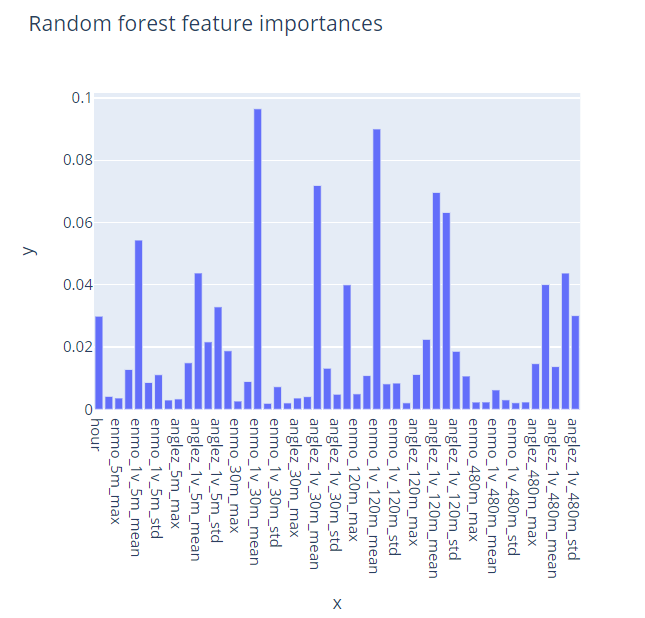

In [13]:
# Checking performance on validation set
#rf_submission = get_events(val_data, rf_classifier)

#print(f"Random forest score: {score(val_solution, rf_submission, tolerances, **column_names)}")

In [14]:
# Saving classifier 
import pickle
with open('rf_classifier_5m_8h.pkl', 'wb') as f:
    pickle.dump(rf_classifier, f)

#with open('rf_classifier.pkl', 'rb') as f:
#    rf_classifier = pickle.load(f)

In [ ]:
## Training and validating gradient boost

In [15]:
# With SKL
from sklearn.ensemble import GradientBoostingClassifier

gb_classifier = GradientBoostingClassifier(n_estimators=100, learning_rate=0.05, max_depth=10, random_state=42)
gb_classifier.fit(X_train[feature_cols], y_train)

GradientBoostingClassifier(learning_rate=0.05, max_depth=10, random_state=42)

In [16]:
# Plotting feature importances
px.bar(x=feature_cols, 
       y=gb_classifier.feature_importances_,
       title='Gradient boosting feature importances'
      )

In [18]:
from sklearn.model_selection import train_test_split

train_ids, val_ids = train_test_split(series_ids, train_size=0.7, random_state=42)

# We will collect datapoints at 10 minute intervals for training for validating
# train_data = train_series.filter(pl.col('series_id').is_in(train_ids)).take_every(12 * 10).collect()

val_data = train_series.filter(pl.col('series_id').is_in(val_ids)).collect()
val_solution = train_events.filter(pl.col('series_id').is_in(val_ids)).select(['series_id', 'event', 'step']).to_pandas()

In [19]:

# Checking performance on validation set
gb_submission = get_events(val_data, gb_classifier)

print(f"Gradient boosting score: {score(val_solution, gb_submission, tolerances, **column_names)}")


100%|██████████| 81/81 [24:25<00:00, 18.09s/it]


NameError: name 'score' is not defined